In [1]:
import warnings
warnings.filterwarnings("ignore")

In [43]:
from __future__ import print_function
import os
import sys
import pandas as pd
import numpy as np
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns
import datetime
from scipy.stats import kstest
from sklearn.impute import KNNImputer
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
from keras.layers import Dense, Input, Dropout
from keras.optimizers import SGD
from keras.models import Model
from keras.models import load_model
from keras.callbacks import ModelCheckpoint
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error

In [3]:
BRAEnergy = pd.read_csv('Simples_Carga_de_Energia_Dia_Hora_data.csv', sep = ';')
BRAEnergy.drop(['Data Escala de Tempo 1 CDH Simp 4.1', 'Subsistema'], axis=1, inplace = True)
BRAEnergy.rename(columns={'Data Escala de Tempo 1 CDH Simp 4': 'date_time', 'Selecione Tipo de CDH Simp 4':'energy'}, inplace=True)
BRAEnergy['date_time'] =  pd.to_datetime(BRAEnergy['date_time'], format='%d/%m/%Y %H:%M:%S')
BRAEnergy.set_index('date_time', inplace = True)
BRAEnergy.head()

,energy
date_time,
1999-01-01 00:00:00,35173.5
1999-01-01 01:00:00,33770.9
1999-01-01 02:00:00,32155.6
1999-01-01 03:00:00,30645.9
1999-01-01 04:00:00,29681.6


In [4]:
date_time_np = BRAEnergy.index

In [5]:
nan_count = BRAEnergy.isna().sum()
print('NaN values amount: ', nan_count)

NaN values amount:  energy    0
dtype: int64


- There is no missing data associated with energy consumption

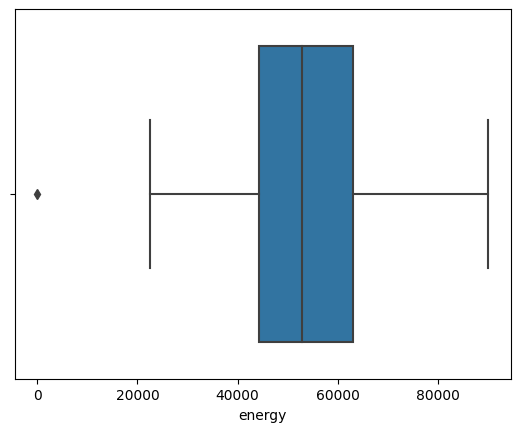

In [6]:
sns.boxplot(x=BRAEnergy["energy"])
plt.show()

- The summary statistics show significant proximity between the mean and median, which is an indication of symmetry in the data, which can be confirmed by the boxplot.

In [7]:
kstest(BRAEnergy.energy, 'norm')

KstestResult(statistic=0.9999951976180186, pvalue=0.0, statistic_location=22601.86, statistic_sign=-1)

- Since the  𝑝 -value is less than .05, we reject the null hypothesis of the Kolmogorov-Smirnov test. This means we have sufficient evidence to say that the sample data does not come from a normal distribution

In [8]:
count = (BRAEnergy['energy'] == 0).sum()
print('Count of zeros in column energy: ', count)
BRAEnergy[BRAEnergy['energy'] == 0]

Count of zeros in column energy:  1


,energy
date_time,
2018-11-04,0.0


- The zero data displayed in the boxplot corresponds to the energy consumption record at the following date and time: 04/11/2018 00:00:00:00

In [9]:
BRAEnergy['energy'] = BRAEnergy['energy'].replace(0, np.nan)

In [10]:
imputer = KNNImputer(n_neighbors=6)
BRAEnergy = pd.DataFrame(imputer.fit_transform(BRAEnergy), columns = BRAEnergy.columns)

In [11]:
nan_count = BRAEnergy.isna().sum()
print('NaN values amount: ', nan_count)

NaN values amount:  energy    0
dtype: int64


In [12]:
BRAEnergy['date_time'] = date_time_np
BRAEnergy.set_index('date_time', inplace = True)
BRAEnergy.head()

,energy
date_time,
1999-01-01 00:00:00,35173.5
1999-01-01 01:00:00,33770.9
1999-01-01 02:00:00,32155.6
1999-01-01 03:00:00,30645.9
1999-01-01 04:00:00,29681.6


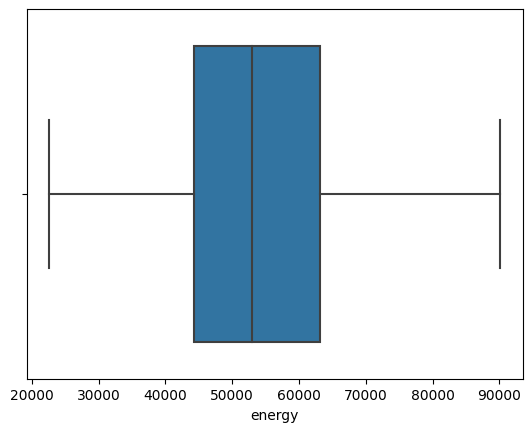

In [13]:
sns.boxplot(x=BRAEnergy["energy"])
plt.show()

In [14]:
fig = px.line(BRAEnergy, x=BRAEnergy.index, y=BRAEnergy.energy)
fig.show()

# MLPs

In [15]:
BRAEnergy = pd.read_csv('Simples_Carga_de_Energia_Dia_Hora_data.csv', sep = ';')
BRAEnergy.drop(['Data Escala de Tempo 1 CDH Simp 4.1', 'Subsistema'], axis=1, inplace = True)
BRAEnergy.rename(columns={'Data Escala de Tempo 1 CDH Simp 4': 'date_time', 'Selecione Tipo de CDH Simp 4':'energy'}, inplace=True)
BRAEnergy['date_time'] =  pd.to_datetime(BRAEnergy['date_time'], format='%d/%m/%Y %H:%M:%S')
BRAEnergy.head()

,date_time,energy
0,1999-01-01 00:00:00,35173.5
1,1999-01-01 01:00:00,33770.9
2,1999-01-01 02:00:00,32155.6
3,1999-01-01 03:00:00,30645.9
4,1999-01-01 04:00:00,29681.6


- Scaling the training data to be in the range  (0,1)

In [16]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
BRAEnergy['scaled_Energy'] = scaler.fit_transform(np.array(BRAEnergy['energy']).reshape(-1, 1))

- Before training the model, the dataset is split into two parts, train set and validation set

In [17]:
train_start_dt = datetime.datetime.strptime('2021-09-16 00:00:00', "%Y-%m-%d %H:%M:%S")
test_start_dt  = datetime.datetime.strptime('2022-09-16 00:00:00', "%Y-%m-%d %H:%M:%S")

In [18]:
train = BRAEnergy.loc[(BRAEnergy['date_time'] >= train_start_dt) & (BRAEnergy['date_time'] <= test_start_dt)]

test = BRAEnergy.loc[BRAEnergy['date_time']> test_start_dt]

In [19]:
print('Training data shape: ', train.shape)
print('Test data shape: ', test.shape)

Training data shape:  (8761, 3)
Test data shape:  (720, 3)


In [20]:
train.head()

,date_time,energy,scaled_Energy
198749,2021-09-16 00:00:00,69420.499,0.770312
198750,2021-09-16 01:00:00,66341.235,0.736143
198751,2021-09-16 02:00:00,64305.567,0.713555
198752,2021-09-16 03:00:00,63303.469,0.702435
198753,2021-09-16 04:00:00,63259.625,0.701949


In [21]:
test.head()

,date_time,energy,scaled_Energy
207510,2022-09-16 01:00:00,62740.968972,0.696194
207511,2022-09-16 02:00:00,60720.016044,0.673768
207512,2022-09-16 03:00:00,59881.922029,0.664469
207513,2022-09-16 04:00:00,60174.849046,0.667719
207514,2022-09-16 05:00:00,61733.583018,0.685015


In [22]:
#Reset the indices of the train set
test.reset_index(drop=True, inplace=True)
test.head()

,date_time,energy,scaled_Energy
0,2022-09-16 01:00:00,62740.968972,0.696194
1,2022-09-16 02:00:00,60720.016044,0.673768
2,2022-09-16 03:00:00,59881.922029,0.664469
3,2022-09-16 04:00:00,60174.849046,0.667719
4,2022-09-16 05:00:00,61733.583018,0.685015


In [23]:
#Reset the indices of the test set
train.reset_index(drop=True, inplace=True)
train.head()

,date_time,energy,scaled_Energy
0,2021-09-16 00:00:00,69420.499,0.770312
1,2021-09-16 01:00:00,66341.235,0.736143
2,2021-09-16 02:00:00,64305.567,0.713555
3,2021-09-16 03:00:00,63303.469,0.702435
4,2021-09-16 04:00:00,63259.625,0.701949


- The variable minmax scaled is used for developing the time series forecasting model. For making prediction on the original variable ENERGY, we apply suitable inverse transformation on the model’s prediction

In [24]:
fig = px.line(train, x=train.date_time, y=train.energy, title = 'Time series of Energy in train set')
fig.show()

In [25]:
fig = px.line(test, x=test.date_time, y=test.energy, title = 'Time series of Energy in test set', color_discrete_sequence=['red'])
fig.show()

In [26]:
# For the time series forecasting model, the past seven hours of observations are used to predict for the next hour (This is equivalent to an AR(7) model.)

In [27]:
def makeXy(ts, nb_timesteps):
    """
    Input: 
           ts: original time series
           nb_timesteps: number of time steps in the regressors
    Output: 
           X: 2-D array of regressors
           y: 1-D array of target 
    """
    X = []
    y = []
    for i in range(nb_timesteps, ts.shape[0]):
        X.append(list(ts.loc[i-nb_timesteps:i-1]))
        y.append(ts.loc[i])
    X, y = np.array(X), np.array(y)
    return X, y

In [28]:
X_train, y_train = makeXy(train['scaled_Energy'], 7)
print('Shape of train arrays:', X_train.shape, y_train.shape)

Shape of train arrays: (8754, 7) (8754,)


In [29]:
X_test, y_test = makeXy(test['scaled_Energy'], 7)
print('Shape of test arrays:', X_test.shape, y_test.shape)

Shape of test arrays: (713, 7) (713,)


- Now we define the MLP using the Keras Functional API. In this approach a layer can be declared as the input of the following layer at the time of defining the next layer.

In [30]:
#Define input layer which has shape (None, 7) and of type float32. None indicates the number of instances
input_layer = Input(shape=(7,), dtype='float32')

In [31]:
#Dense layers are defined with linear activation
dense1 = Dense(32, activation='linear')(input_layer)
dense2 = Dense(16, activation='linear')(dense1)
dense3 = Dense(16, activation='linear')(dense2)

In [32]:
dropout_layer = Dropout(0.2)(dense3)

In [33]:
# the output layer gives prediction for the next day's energy consumption.
output_layer = Dense(1, activation='linear')(dropout_layer)

In [34]:
ts_model = Model(inputs=input_layer, outputs=output_layer)
ts_model.compile(loss='mean_squared_error', optimizer='adam')
ts_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 7)]               0         
                                                                 
 dense (Dense)               (None, 32)                256       
                                                                 
 dense_1 (Dense)             (None, 16)                528       
                                                                 
 dense_2 (Dense)             (None, 16)                272       
                                                                 
 dropout (Dropout)           (None, 16)                0         
                                                                 
 dense_3 (Dense)             (None, 1)                 17        
                                                                 
Total params: 1,073
Trainable params: 1,073
Non-trainable par

In [37]:
save_weights_at = os.path.join('keras_models', 'BRAEnergy.{epoch:02d}-{val_loss:.4f}.hdf5')
save_best = ModelCheckpoint(save_weights_at, monitor='val_loss', verbose=0,
                            save_best_only=True, save_weights_only=False, mode='min',
                            period=1)
ts_model.fit(x=X_train, y=y_train, batch_size=16, epochs=20,
             verbose=1, callbacks=[save_best], validation_data=(X_test, y_test),
             shuffle=True)

Epoch 1/20
548/548 [==============================] - 1s 2ms/step - loss: 5.6230e-04 - val_loss: 3.1043e-04
Epoch 2/20
548/548 [==============================] - 1s 2ms/step - loss: 5.5062e-04 - val_loss: 4.1179e-04
Epoch 3/20
548/548 [==============================] - 2s 3ms/step - loss: 5.6155e-04 - val_loss: 5.6403e-04
Epoch 4/20
548/548 [==============================] - 1s 2ms/step - loss: 5.6840e-04 - val_loss: 3.0734e-04
Epoch 5/20
548/548 [==============================] - 1s 2ms/step - loss: 5.8240e-04 - val_loss: 3.8174e-04
Epoch 6/20
548/548 [==============================] - 1s 2ms/step - loss: 5.2042e-04 - val_loss: 8.2974e-04
Epoch 7/20
548/548 [==============================] - 1s 2ms/step - loss: 5.5841e-04 - val_loss: 2.8869e-04
Epoch 8/20
548/548 [==============================] - 1s 2ms/step - loss: 5.3513e-04 - val_loss: 3.3526e-04
Epoch 9/20
548/548 [==============================] - 2s 3ms/step - loss: 5.2967e-04 - val_loss: 2.8967e-04
Epoch 10/20
548/548 [=======

In [39]:
best_model = load_model(os.path.join('\ConsumoEnergia','keras_models', 'BRAEnergy.14-0.0003.hdf5'))
preds = best_model.predict(X_test)
pred_Energy = scaler.inverse_transform(preds)
pred_Energy = np.squeeze(pred_Energy)

23/23 [==============================] - 0s 3ms/step


In [48]:
r2 = r2_score(test['energy'].loc[7:], pred_Energy)
print('R-squared for test set:', round(r2,4))
#mae = mean_absolute_error(test['energy'].loc[7:], pred_Energy)
#print('MAE for test set:', round(mae, 4))

MAE for test set: 1087.5693
R-squared for test set: 0.9667


Text(0.5, 0, 'Index')

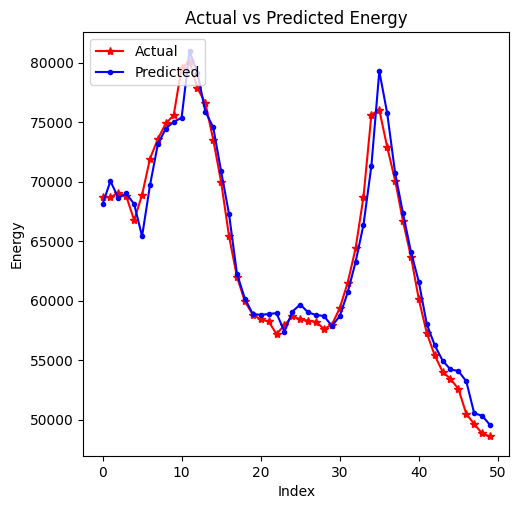

In [42]:
#Let's plot the first 50 actual and predicted values of air pressure.
plt.figure(figsize=(5.5, 5.5))
plt.plot(range(50), test['energy'].loc[7:56], linestyle='-', marker='*', color='r')
plt.plot(range(50), pred_Energy[:50], linestyle='-', marker='.', color='b')
plt.legend(['Actual','Predicted'], loc=2)
plt.title('Actual vs Predicted Energy')
plt.ylabel('Energy')
plt.xlabel('Index')